In [3]:
import numpy as np
import matplotlib.pyplot as plt
samples = np.fromfile('RawIQ.iq', np.complex64) # Read in file.  We have to tell it what format it is
print(len(samples))

6857000


In [4]:
from itertools import groupby
from operator import itemgetter
def frameFinder(samples):
    test_list = np.nonzero(samples)
    framesIndex = []
    for k, g in groupby(enumerate(test_list[0]), lambda ix: ix[0]-ix[1]):
        temp = list(map(itemgetter(1), g))
        if len(temp)< 1000:
            continue
        framesIndex.append([temp[0],temp[-1]])
    return np.array(framesIndex)
TotalFramesIndex = frameFinder(samples)

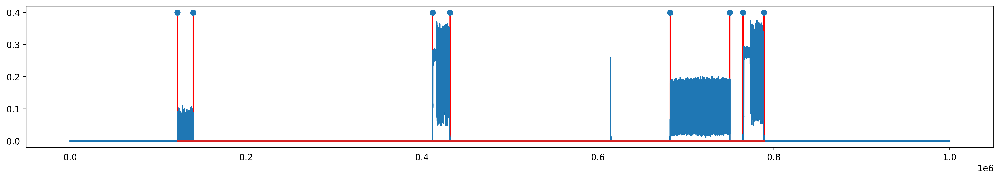

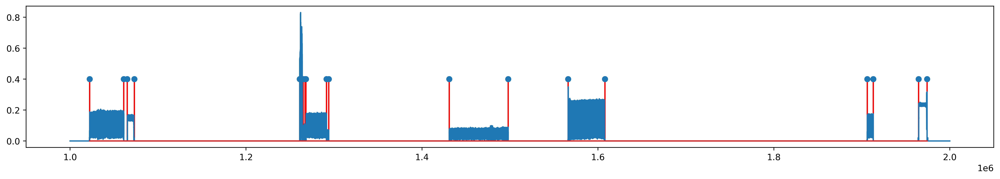

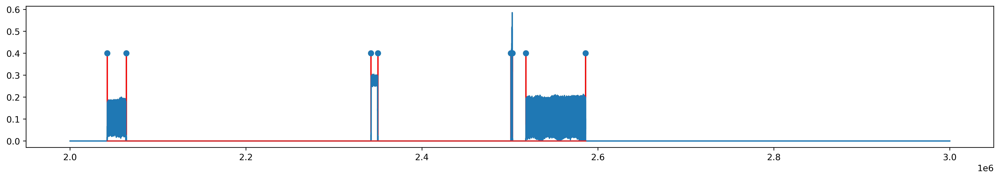

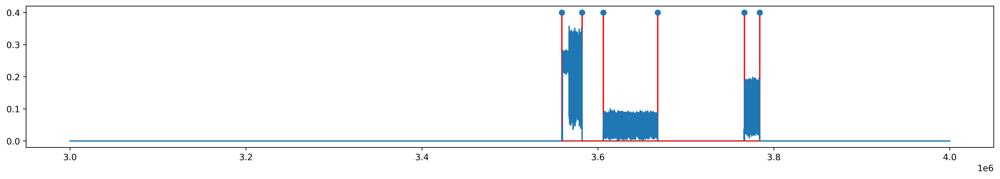

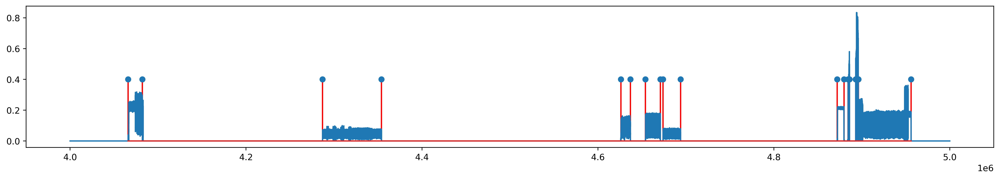

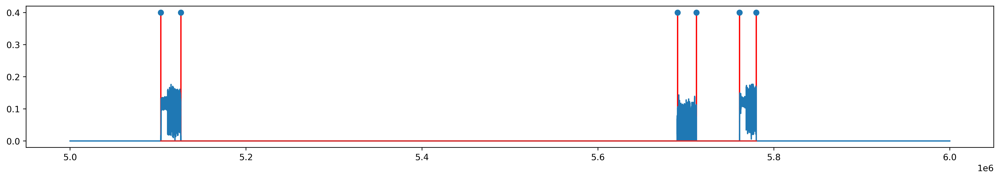

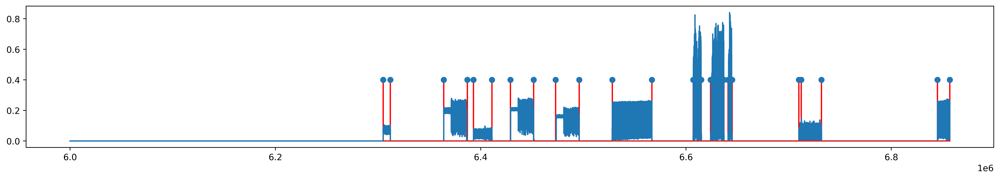

In [5]:
batchAna = 1000000
start = 0 
for i in range(len(samples)//batchAna+1):
    x = samples[start:start + batchAna]
    framesIndex = frameFinder(x)
    plt.figure(figsize=(20, 3), dpi=500)
    plt.plot(np.linspace(start,  start+len(x), len(x)),np.abs(x))
    plt.stem(np.add(framesIndex.flatten(),[start]*len(framesIndex)*2), [.4]*len(framesIndex.flatten()) ,'r')
    # # lt.grid(True)
    plt.show()
    plt.close()
    start += batchAna

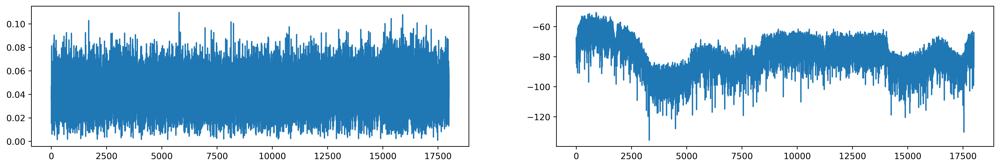

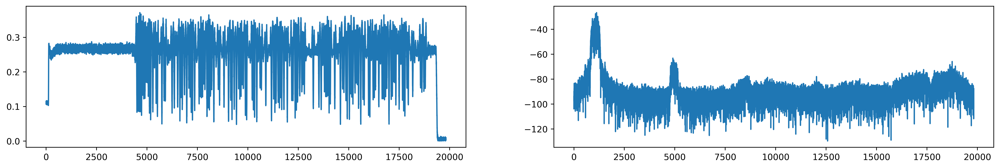

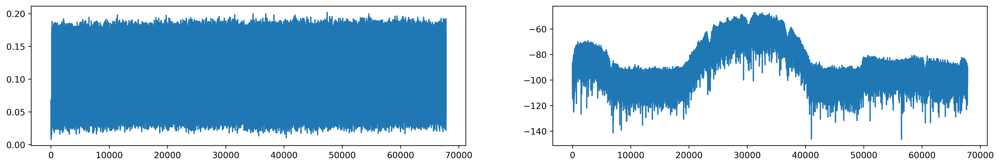

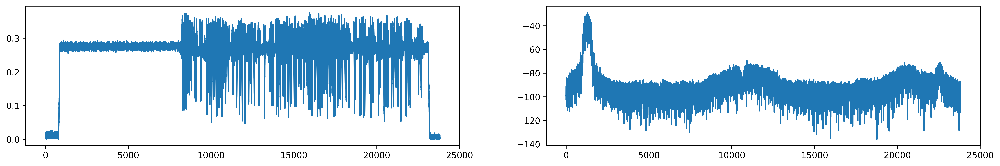

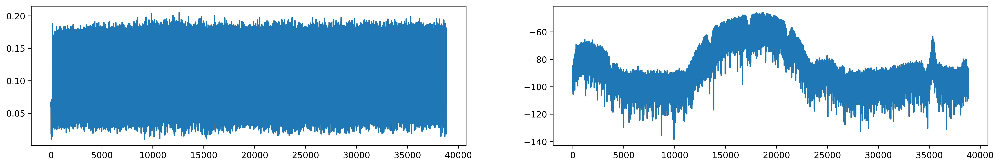

...

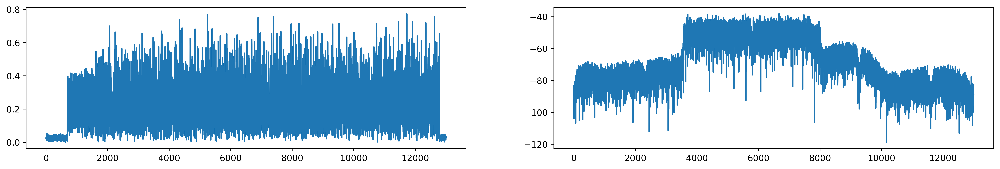

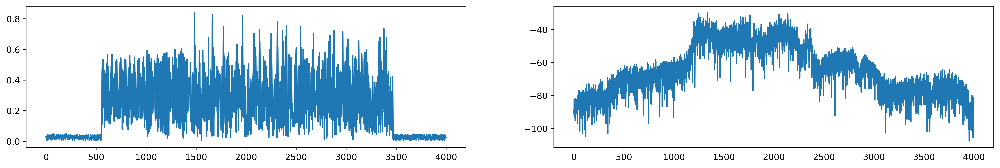

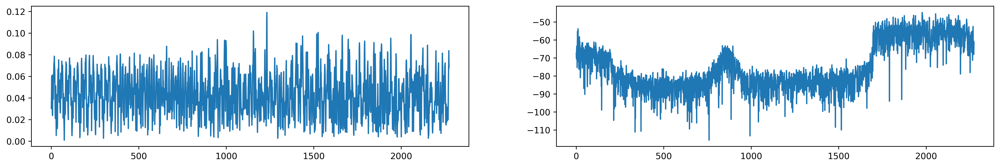

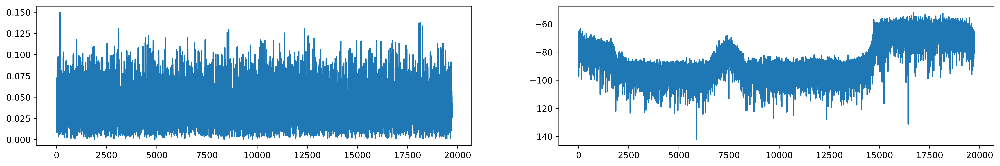

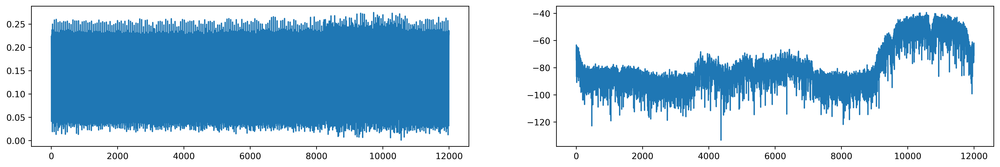

In [8]:
frames = []
for i,j in TotalFramesIndex:
    frames.append(samples[i:j])

for frame in frames:
    PSD = (np.abs(np.fft.fft(frame))/len(frame))**2
    PSD_log = 10.0*np.log10(PSD)
    PSD_shifted = np.fft.fftshift(PSD_log)
    plt.figure(figsize=(20, 3), dpi=500)
    plt.subplot(1,2,1)
    plt.plot(np.abs(frame))
    plt.subplot(1,2,2)
    plt.plot(PSD_shifted)
    plt.show()